## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

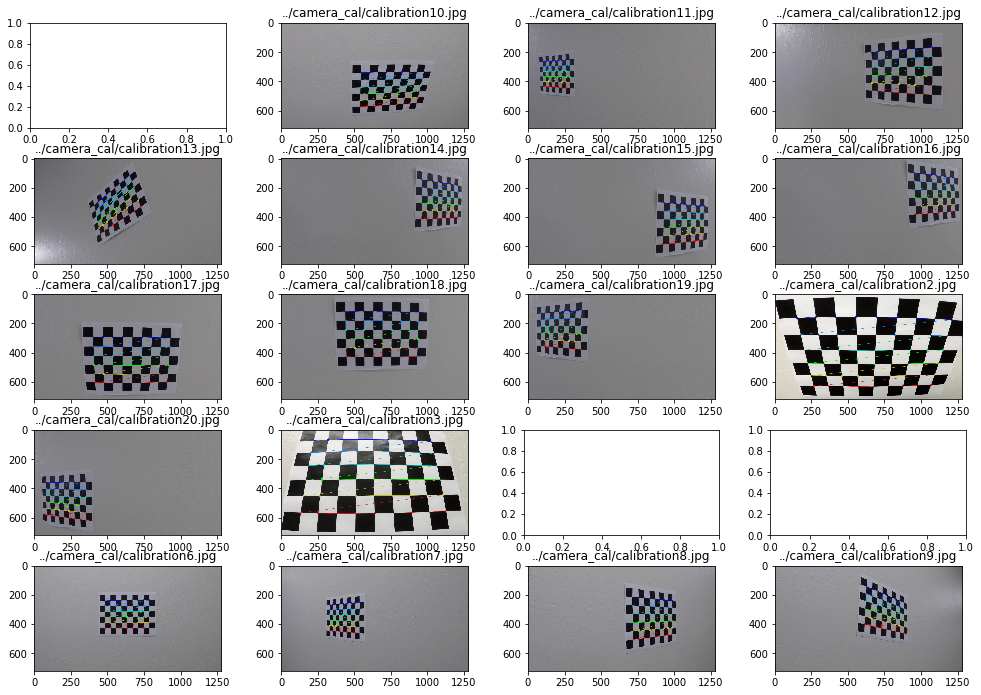

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('../camera_cal/calibration*.jpg')

f, axs = plt.subplots((len(images)-1)//4+1, 4, figsize=(13, 10))
f.tight_layout()

# Step through the list and search for chessboard corners
for index, fname in enumerate(images):
    img = mpimg.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        axs.flat[index].imshow(img)
        axs.flat[index].set_title(fname)

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Calibrate camera and undistort chessboard images

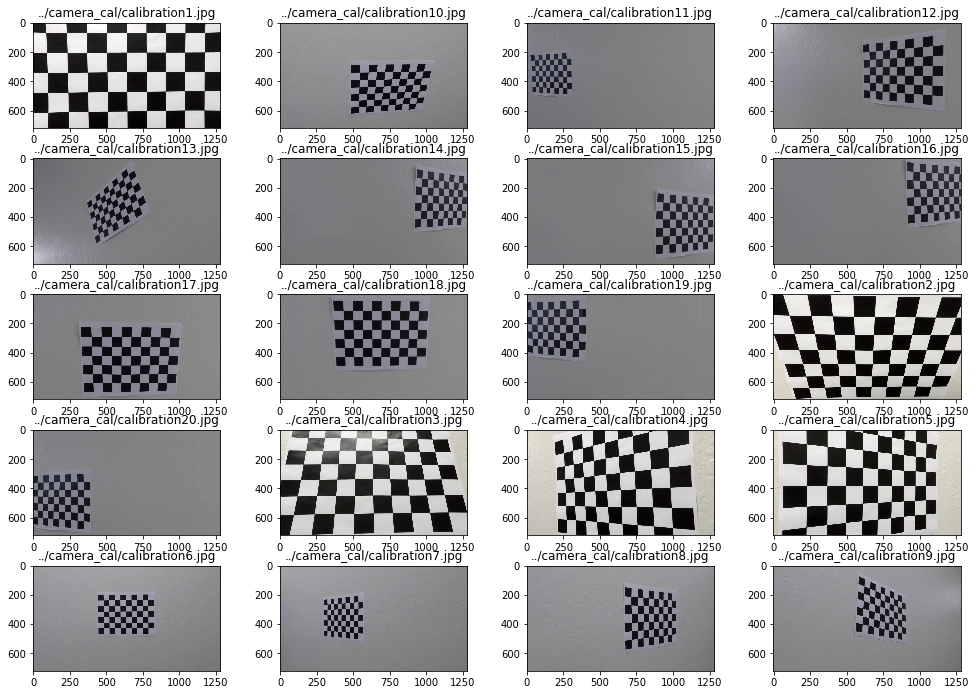

In [2]:
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

# Make a list of calibration images
images = glob.glob('../camera_cal/calibration*.jpg')

f, axs = plt.subplots((len(images)-1)//4+1, 4, figsize=(13, 10))
f.tight_layout()

# Step through the list and search for chessboard corners
for index, fname in enumerate(images):
    img = mpimg.imread(fname)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    axs.flat[index].imshow(dst)
    axs.flat[index].set_title(fname)

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Undistort test images

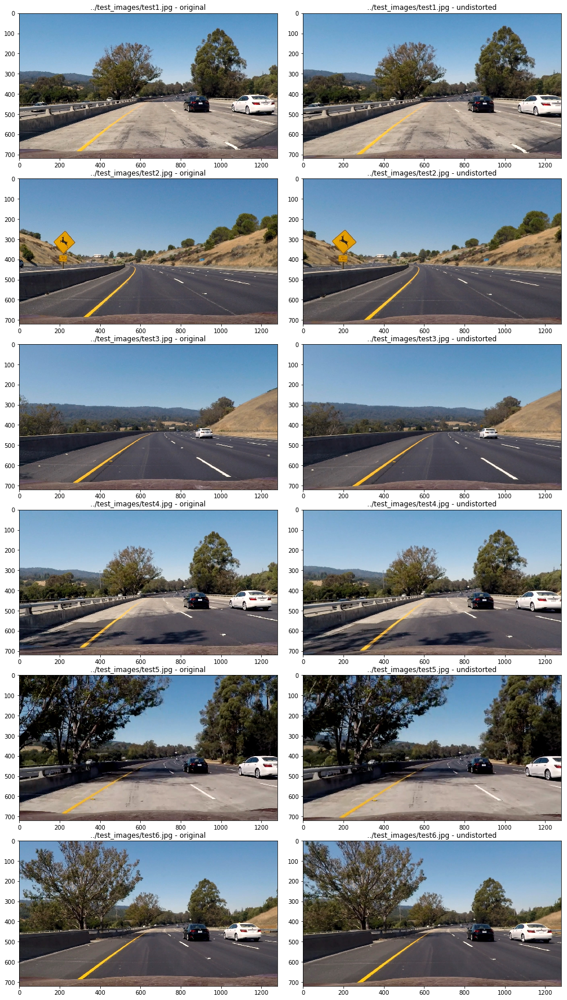

In [3]:
# Make a list of test images
images = glob.glob('../test_images/test*.jpg')

f, axs = plt.subplots(len(images), 2, figsize=(13, 26))
f.tight_layout()

# Step through the list and search for chessboard corners
for index, fname in enumerate(images):
    img = mpimg.imread(fname)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    axs.flat[index*2].imshow(img)
    axs.flat[index*2].set_title('{} - original'.format(fname))
    axs.flat[index*2+1].imshow(dst)
    axs.flat[index*2+1].set_title('{} - undistorted'.format(fname))

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Get binary images after color transforms and gradients

In [4]:
def get_binary(img,
               yellow_h_thresh=(15, 25), 
               white_l_thresh=(180, 255), 
               white_s_thresh=(0, 120), 
               sx_thresh=(12, 100)):
    img = np.copy(img)
    # Convert to HLS color space and separate the L & S channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
        
    # Find yellow area
    yellow_binary = np.zeros_like(h_channel)
    yellow_binary[(h_channel >= yellow_h_thresh[0]) & (h_channel <= yellow_h_thresh[1])] = 1
    
    # Find white area
    white_binary = np.zeros_like(l_channel)
    white_binary[(l_channel >= white_l_thresh[0]) & 
                 (l_channel <= white_l_thresh[1]) &
                 (s_channel >= white_s_thresh[0]) &
                 (s_channel <= white_s_thresh[1])] = 1

    # Sobel x
    sobelx_s = cv2.Sobel(s_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx_s = np.absolute(sobelx_s) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel_s = np.uint8(255*abs_sobelx_s/np.max(abs_sobelx_s))

    # Threshold x gradient
    sxbinary_s = np.zeros_like(scaled_sobel_s)
    sxbinary_s[(scaled_sobel_s >= sx_thresh[0]) & 
             (scaled_sobel_s <= sx_thresh[1]) & 
             ((yellow_binary == 1) | (white_binary == 1))] = 1

    # Sobel x
    sobelx_l = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx_l = np.absolute(sobelx_l) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel_l = np.uint8(255*abs_sobelx_l/np.max(abs_sobelx_l))

    # Threshold x gradient
    sxbinary_l = np.zeros_like(scaled_sobel_l)
    sxbinary_l[(scaled_sobel_l >= sx_thresh[0]) & 
             (scaled_sobel_l <= sx_thresh[1]) & 
             ((yellow_binary == 1) | (white_binary == 1))] = 1
    
    sxbinary = np.zeros_like(scaled_sobel_s)
    sxbinary[(sxbinary_s == 1) | (sxbinary_l == 1)] = 1
    
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
#    color_binary = np.dstack(( h_binary, sxbinary, s_binary))
    color_binary = np.dstack(( yellow_binary, white_binary, sxbinary))
    
    combined_binary = sxbinary
#    combined_binary[(h_binary == 1) | (sxbinary == 1) | (l_binary == 1)] = 1
    return color_binary, combined_binary

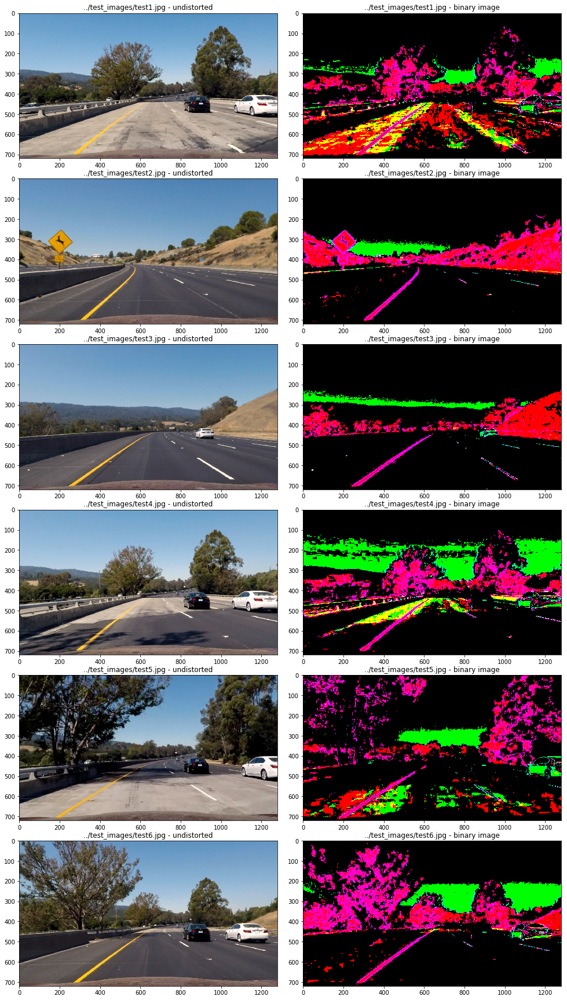

In [5]:
# Make a list of test images
images = glob.glob('../test_images/test*.jpg')

f, axs = plt.subplots(len(images), 2, figsize=(13, 26))
f.tight_layout()

# Step through the list and search for chessboard corners
for index, fname in enumerate(images):
    img = mpimg.imread(fname)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    color_binary, combined_binary = get_binary(dst)
    axs.flat[index*2].imshow(dst)
    axs.flat[index*2].set_title('{} - undistorted'.format(fname))
    axs.flat[index*2+1].imshow(color_binary)
    axs.flat[index*2+1].set_title('{} - binary image'.format(fname))

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Apply Perspective Transform

In [6]:
# Get perspective transform matrix
img = mpimg.imread('../test_images/test1.jpg')
img_size = (img.shape[1], img.shape[0])
src = np.float32(
    [[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
     [((img_size[0] / 6) - 10), img_size[1]],
     [(img_size[0] * 5 / 6) + 60, img_size[1]],
     [(img_size[0] / 2 + 55), img_size[1] / 2 + 100]])
dst = np.float32(
    [[(img_size[0] / 4), 0],
     [(img_size[0] / 4), img_size[1]],
     [(img_size[0] * 3 / 4), img_size[1]],
     [(img_size[0] * 3 / 4), 0]])
M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)

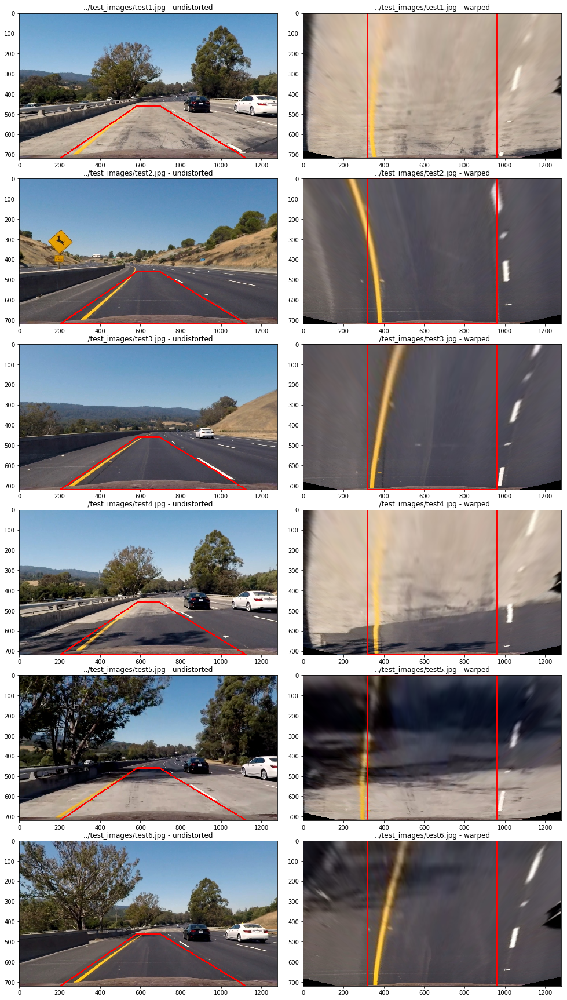

In [7]:
# Apply perspective transform to test images

# Make a list of test images
images = glob.glob('../test_images/test*.jpg')

f, axs = plt.subplots(len(images), 2, figsize=(13, 26))
f.tight_layout()

# Step through the list and search for chessboard corners
for index, fname in enumerate(images):
    img = mpimg.imread(fname)
    undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    result = cv2.warpPerspective(undistorted, M, img_size, flags=cv2.INTER_LINEAR)
    src_pts = src.astype(int).reshape((-1,1,2))
    dst_pts = dst.astype(int).reshape((-1,1,2))
    cv2.polylines(undistorted, [src_pts], True, (255, 0, 0), thickness = 5)
    cv2.polylines(result, [dst_pts], True, (255, 0, 0), thickness = 5)
    axs.flat[index*2].imshow(undistorted)
    axs.flat[index*2].set_title('{} - undistorted'.format(fname))
    axs.flat[index*2+1].imshow(result)
    axs.flat[index*2+1].set_title('{} - warped'.format(fname))

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Find window centroid

In [8]:
nwindows = 9
window_width = 50 
margin = 100 # How much to slide left and right for searching

def find_lane_lines(binary_warped):
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    # Set height of windows
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set minimum number of pixels found to recenter window
    minpix = 30
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    out_img[np.int_(ploty), np.clip(np.int_(left_fitx), 0, 1279)] = [255, 255, 0]
    out_img[np.int_(ploty), np.clip(np.int_(right_fitx), 0, 1279)] = [255, 255, 0]

    # Measure curvature
    y_eval = np.max(ploty)
    
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(out_img, "Left: {:.0f}m, Right: {:.0f}m".format(left_curverad, right_curverad),(20,50), font, 1,(0,255,255),3,cv2.LINE_AA)
    
    return out_img

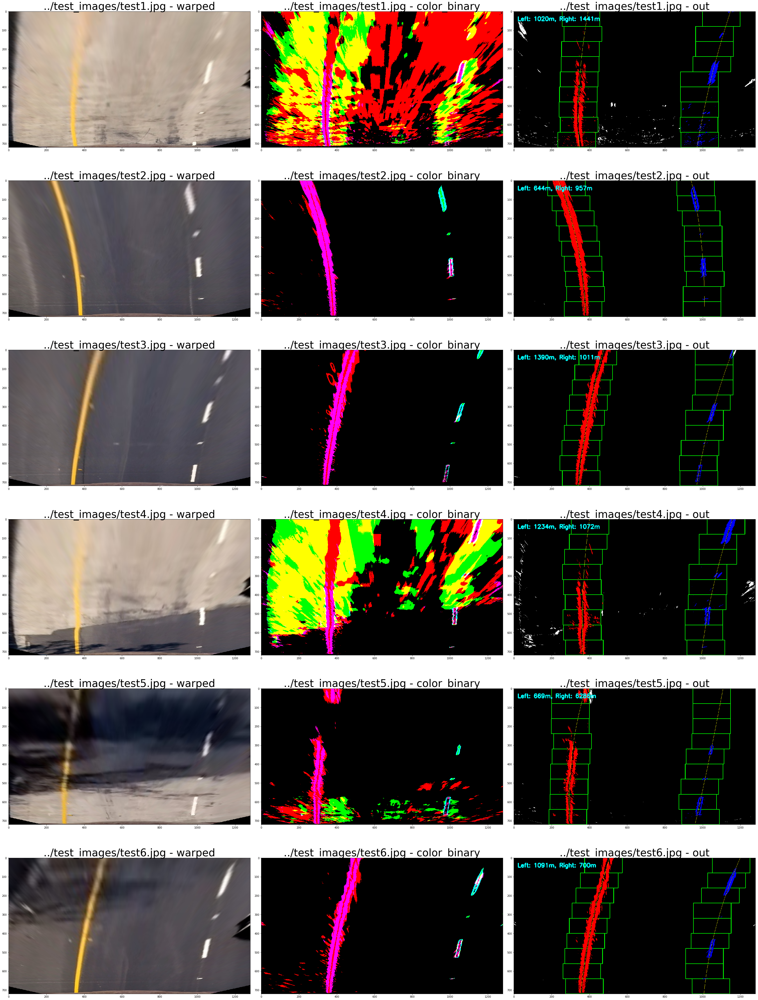

In [9]:
# Make a list of test images
images = glob.glob('../test_images/test*.jpg')

f, axs = plt.subplots(len(images), 3, figsize=(40, 60))
f.tight_layout()

# Step through the list and search for chessboard corners
for index, fname in enumerate(images):
    img = mpimg.imread(fname)
    undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    warped = cv2.warpPerspective(undistorted, M, img_size, flags=cv2.INTER_LINEAR)
    color_binary, combined_binary = get_binary(warped)
    out = find_lane_lines(combined_binary)
  
    axs.flat[index*3].imshow(warped, cmap="gray")
    axs.flat[index*3].set_title('{} - warped'.format(fname), fontsize=40)
    axs.flat[index*3+1].imshow(color_binary)
    axs.flat[index*3+1].set_title('{} - color_binary'.format(fname), fontsize=40)
    axs.flat[index*3+2].imshow(out)
    axs.flat[index*3+2].set_title('{} - out'.format(fname), fontsize=40)
    
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Test images

In [17]:
nwindows = 9
window_width = 50 
margin = 100 # How much to slide left and right for searching

def draw_lane_lines(undistorted, binary_warped):
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    # Set height of windows
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (undistorted.shape[1], undistorted.shape[0])) 

    # Measure curvature
    y_eval = np.max(ploty)
    
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    # Center 
    center_x = (((left_fitx[719] + right_fitx[719]) / 2) - 640) * xm_per_pix * 100
    
    curverad = (left_curverad + right_curverad) / 2
    curverad_dif = abs(left_curverad - right_curverad) / curverad * 100
    
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.rectangle(newwarp, (10, 10), (1270, 90), (255, 255, 255), thickness=-1)
    cv2.putText(newwarp, "Curve Radius: {:.0f}m, Difference: {:.0f}%".format(curverad, curverad_dif),(20,40), font, 1,(0,0,0),1,cv2.LINE_AA)
    cv2.putText(newwarp, "Center: {:.0f}cm".format(center_x),(20,80), font, 1,(0,0,0),1,cv2.LINE_AA)

    # Combine the result with the original image
    result = cv2.addWeighted(undistorted, 1, newwarp, 0.5, 0)

    return result

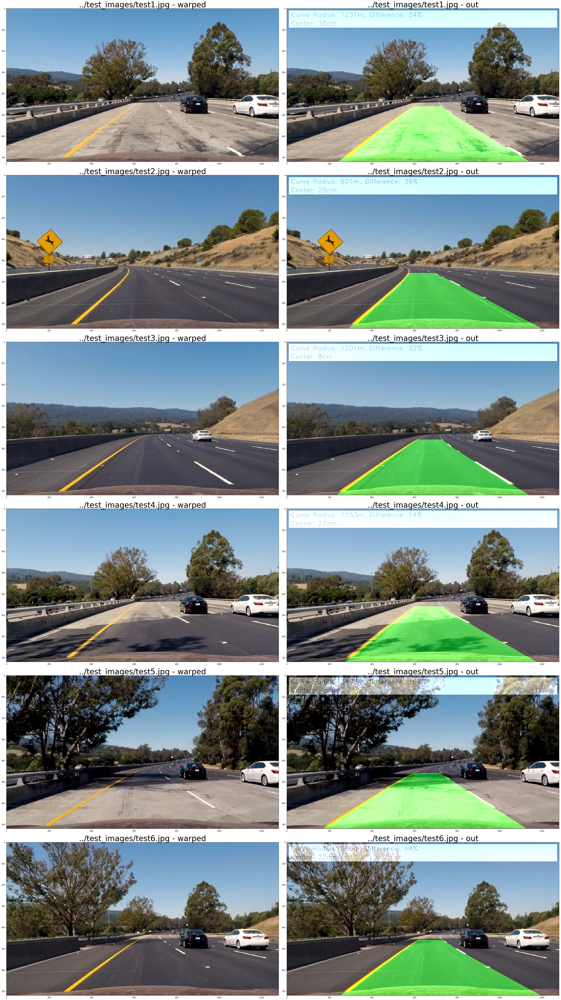

In [18]:
# Make a list of test images
images = glob.glob('../test_images/test*.jpg')

f, axs = plt.subplots(len(images), 2, figsize=(40, 80))
f.tight_layout()

# Step through the list and search for chessboard corners
for index, fname in enumerate(images):
    img = mpimg.imread(fname)
    undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    binary_warped = cv2.warpPerspective(undistorted, M, img_size, flags=cv2.INTER_LINEAR)
    color_binary, combined_binary = get_binary(binary_warped)
    out = draw_lane_lines(undistorted, combined_binary)
  
    axs.flat[index*2].imshow(undistorted)
    axs.flat[index*2].set_title('{} - warped'.format(fname), fontsize=40)
    axs.flat[index*2+1].imshow(out)
    axs.flat[index*2+1].set_title('{} - out'.format(fname), fontsize=40)
    
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Video pipeline

In [12]:
def pipeline(img):
    undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    binary_warped = cv2.warpPerspective(undistorted, M, img_size, flags=cv2.INTER_LINEAR)
    color_binary, combined_binary = get_binary(binary_warped)
    out = draw_lane_lines(undistorted, combined_binary)
    return out

In [13]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

video_output = 'project_video_output.mp4'
clip1 = VideoFileClip("../project_video.mp4")
output_clip = clip1.fl_image(pipeline) #NOTE: this function expects color images!!
%time output_clip.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████▉| 1260/1261 [03:24<00:00,  5.83it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 3min 33s, sys: 1min 8s, total: 4min 42s
Wall time: 3min 25s


In [14]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))